# Load Dataset

In [169]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report,cohen_kappa_score

In [170]:
df = pd.read_csv(r"C:\Users\ynaya\Downloads\parkinsons.csv")
df

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


# Profile Report

In [171]:
import pandas_profiling as pr
pr.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Manual EDA

In [172]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5   MDVP:Jitter(Abs)  195 non-null    float64
 6   MDVP:RAP          195 non-null    float64
 7   MDVP:PPQ          195 non-null    float64
 8   Jitter:DDP        195 non-null    float64
 9   MDVP:Shimmer      195 non-null    float64
 10  MDVP:Shimmer(dB)  195 non-null    float64
 11  Shimmer:APQ3      195 non-null    float64
 12  Shimmer:APQ5      195 non-null    float64
 13  MDVP:APQ          195 non-null    float64
 14  Shimmer:DDA       195 non-null    float64
 15  NHR               195 non-null    float64
 16  HNR               195 non-null    float64
 1

From above information we conclude that
- All the attributes are non-null
- Except *name*, all the attributes are numeric
- There are 195 entries
- There are 24 columns

In [173]:
df.describe()

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
count,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,...,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000
mean,154.228641,197.104918,116.324631,0.006220,0.000044,0.003306,0.003446,0.009920,0.029709,0.282251,...,0.046993,0.024847,21.885974,0.753846,0.498536,0.718099,-5.684397,0.226510,2.381826,0.206552
std,41.390065,91.491548,43.521413,0.004848,0.000035,0.002968,0.002759,0.008903,0.018857,0.194877,...,0.030459,0.040418,4.425764,0.431878,0.103942,0.055336,1.090208,0.083406,0.382799,0.090119
min,88.333000,102.145000,65.476000,0.001680,0.000007,0.000680,0.000920,0.002040,0.009540,0.085000,...,0.013640,0.000650,8.441000,0.000000,0.256570,0.574282,-7.964984,0.006274,1.423287,0.044539
25%,117.572000,134.862500,84.291000,0.003460,0.000020,0.001660,0.001860,0.004985,0.016505,0.148500,...,0.024735,0.005925,19.198000,1.000000,0.421306,0.674758,-6.450096,0.174351,2.099125,0.137451
50%,148.790000,175.829000,104.315000,0.004940,0.000030,0.002500,0.002690,0.007490,0.022970,0.221000,...,0.038360,0.011660,22.085000,1.000000,0.495954,0.722254,-5.720868,0.218885,2.361532,0.194052
75%,182.769000,224.205500,140.018500,0.007365,0.000060,0.003835,0.003955,0.011505,0.037885,0.350000,...,0.060795,0.025640,25.075500,1.000000,0.587562,0.761881,-5.046192,0.279234,2.636456,0.252980
max,260.105000,592.030000,239.170000,0.033160,0.000260,0.021440,0.019580,0.064330,0.119080,1.302000,...,0.169420,0.314820,33.047000,1.000000,0.685151,0.825288,-2.434031,0.450493,3.671155,0.527367


<AxesSubplot:>

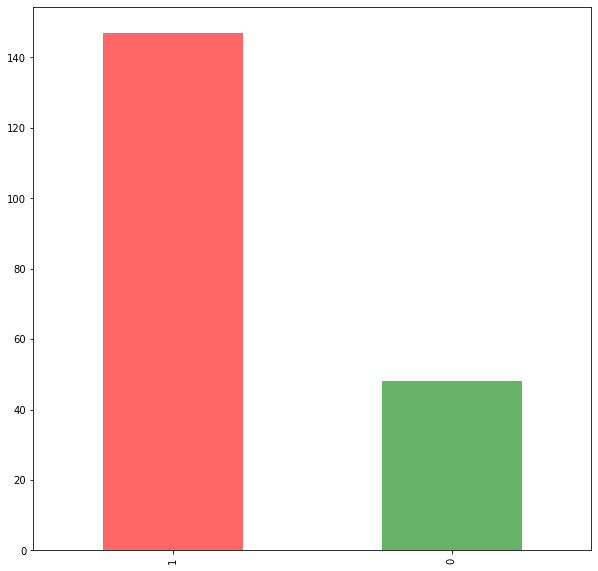

In [174]:
plt.figure(figsize=(10,10))
df["status"].value_counts().plot(kind="bar",color=['r','g'],alpha=0.6)

There are way many people having the disease compared to the healthy ones.

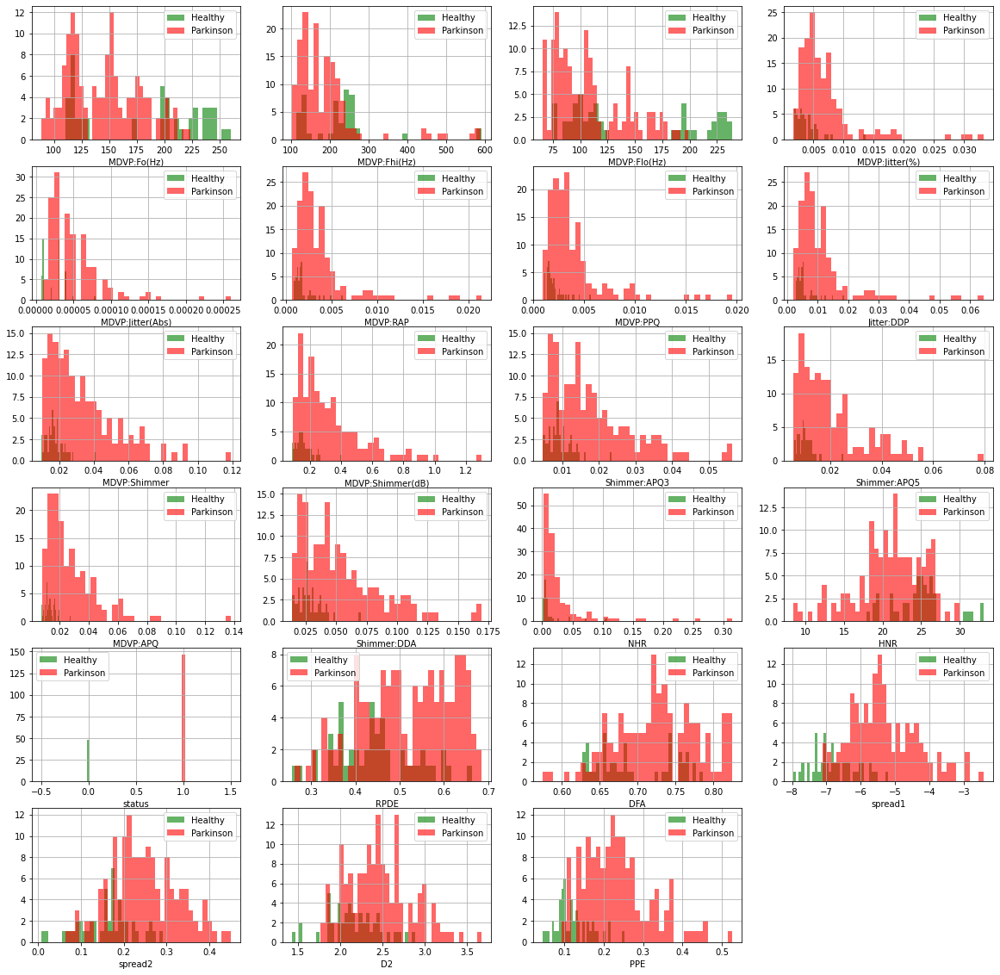

In [175]:
plt.figure(figsize=(20,20))
for i,col in enumerate(df.columns[1:],1):
    plt.subplot(6,4,i)
    df[df.status==0][col].hist(bins=35, color='g', alpha=0.6,label="Healthy")
    df[df.status==1][col].hist(bins=35, color='r', alpha=0.6,label="Parkinson")
    plt.xlabel(col)
    plt.legend()

The above histograms indicate higher chance of having the disease with the readings showing higher frequencies. 

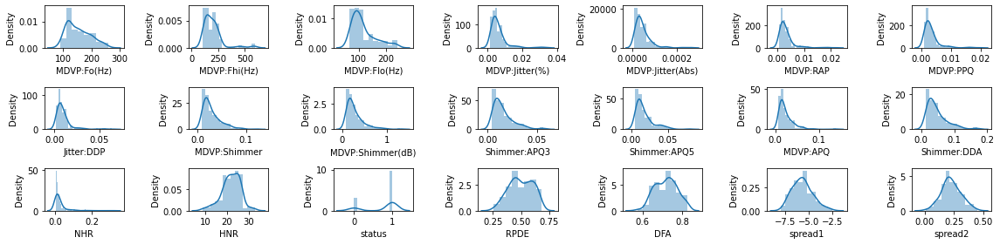

In [176]:
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
rows=3
cols=7
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(16,4))
col=df.columns
index=1
for i in range(rows):
    for j in range(cols):
        sns.distplot(df[col[index]],ax=ax[i][j])
        index=index+1
        
plt.tight_layout()

Most of the values are distributed asymmetricaly like *MDVP:Fo(Hz)*, *MDVP:Flo(Hz)*, *MDVP:Shimmer*

In [177]:
cor = df.corr()
cor

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
MDVP:Fo(Hz),1.000000,0.400985,0.596546,-0.118003,-0.382027,-0.076194,-0.112165,-0.076213,-0.098374,-0.073742,...,-0.094732,-0.021981,0.059144,-0.383535,-0.383894,-0.446013,-0.413738,-0.249450,0.177980,-0.372356
MDVP:Fhi(Hz),0.400985,1.000000,0.084951,0.102086,-0.029198,0.097177,0.091126,0.097150,0.002281,0.043465,...,-0.003733,0.163766,-0.024893,-0.166136,-0.112404,-0.343097,-0.076658,-0.002954,0.176323,-0.069543
MDVP:Flo(Hz),0.596546,0.084951,1.000000,-0.139919,-0.277815,-0.100519,-0.095828,-0.100488,-0.144543,-0.119089,...,-0.150737,-0.108670,0.210851,-0.380200,-0.400143,-0.050406,-0.394857,-0.243829,-0.100629,-0.340071
MDVP:Jitter(%),-0.118003,0.102086,-0.139919,1.000000,0.935714,0.990276,0.974256,0.990276,0.769063,0.804289,...,0.746635,0.906959,-0.728165,0.278220,0.360673,0.098572,0.693577,0.385123,0.433434,0.721543
MDVP:Jitter(Abs),-0.382027,-0.029198,-0.277815,0.935714,1.000000,0.922911,0.897778,0.922913,0.703322,0.716601,...,0.697170,0.834972,-0.656810,0.338653,0.441839,0.175036,0.735779,0.388543,0.310694,0.748162
MDVP:RAP,-0.076194,0.097177,-0.100519,0.990276,0.922911,1.000000,0.957317,1.000000,0.759581,0.790652,...,0.744919,0.919521,-0.721543,0.266668,0.342140,0.064083,0.648328,0.324407,0.426605,0.670999
MDVP:PPQ,-0.112165,0.091126,-0.095828,0.974256,0.897778,0.957317,1.000000,0.957319,0.797826,0.839239,...,0.763592,0.844604,-0.731510,0.288698,0.333274,0.196301,0.716489,0.407605,0.412524,0.769647
Jitter:DDP,-0.076213,0.097150,-0.100488,0.990276,0.922913,1.000000,0.957319,1.000000,0.759555,0.790621,...,0.744901,0.919548,-0.721494,0.266646,0.342079,0.064026,0.648328,0.324377,0.426556,0.671005
MDVP:Shimmer,-0.098374,0.002281,-0.144543,0.769063,0.703322,0.759581,0.797826,0.759555,1.000000,0.987258,...,0.987626,0.722194,-0.835271,0.367430,0.447424,0.159954,0.654734,0.452025,0.507088,0.693771
MDVP:Shimmer(dB),-0.073742,0.043465,-0.119089,0.804289,0.716601,0.790652,0.839239,0.790621,0.987258,1.000000,...,0.963202,0.744477,-0.827805,0.350697,0.410684,0.165157,0.652547,0.454314,0.512233,0.695058


<AxesSubplot:>

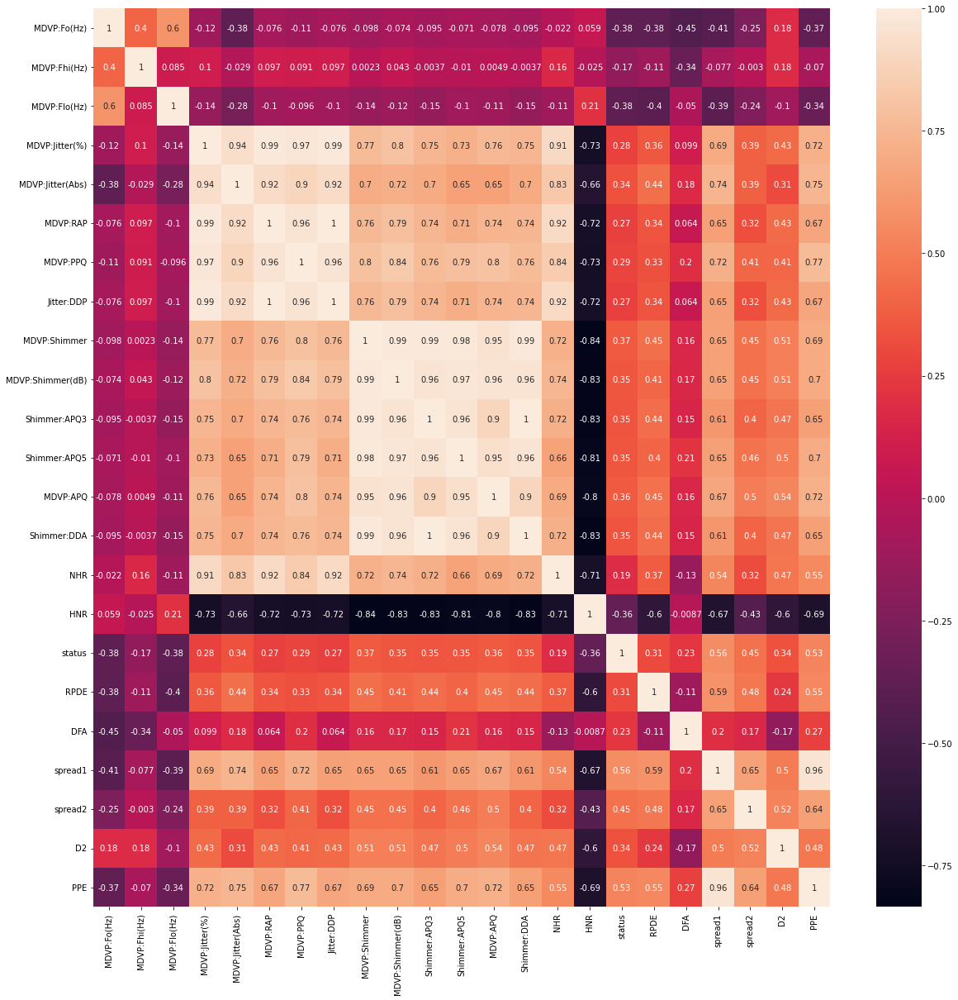

In [178]:
plt.figure(figsize=(20,20))
sns.heatmap(cor,annot=True)

Almost all the features show higher correlation with the target which is *status*

In [179]:
df = df.drop(['name'],axis=1)
df

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,0.426,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,0.626,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,0.482,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,0.517,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,0.584,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,0.405,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,0.263,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,0.256,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,0.241,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


# Build Model

In [180]:
X = df.drop(['status'],axis=1)
X

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,MDVP:APQ,Shimmer:DDA,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE
0,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,0.426,...,0.02971,0.06545,0.02211,21.033,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,0.626,...,0.04368,0.09403,0.01929,19.085,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,0.482,...,0.03590,0.08270,0.01309,20.651,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,0.517,...,0.03772,0.08771,0.01353,20.644,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,0.584,...,0.04465,0.10470,0.01767,19.649,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,0.405,...,0.02745,0.07008,0.02764,19.517,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,0.263,...,0.01879,0.04812,0.01810,19.147,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,0.256,...,0.01667,0.03804,0.10715,17.883,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,0.241,...,0.01588,0.03794,0.07223,19.020,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


In [181]:
Y = df['status']
Y

0      1
1      1
2      1
3      1
4      1
      ..
190    0
191    0
192    0
193    0
194    0
Name: status, Length: 195, dtype: int64

In [182]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.15,random_state=4)

## K Nearest Neighbors

In [183]:
from sklearn.neighbors import KNeighborsClassifier

KNN = KNeighborsClassifier().fit(X_train,Y_train)

pred_train = KNN.predict(X_train)
pred_test = KNN.predict(X_test)

print("Train Accuracy Score : ", accuracy_score(Y_train, pred_train))
print("Test Accuracy Score :  ", accuracy_score(Y_test, pred_test))

print("\nTrain Confusion Matrix:\n ", confusion_matrix(Y_train, pred_train))
print("Test Confusion Matrix:\n ", confusion_matrix(Y_test, pred_test))

print('\nTrain Classification Report:')
print(classification_report (Y_train, pred_train))
print('\nTest Classification Report:')
print(classification_report (Y_test, pred_test))

Train Accuracy Score :  0.8909090909090909
Test Accuracy Score :   0.8

Train Confusion Matrix:
  [[ 24  14]
 [  4 123]]
Test Confusion Matrix:
  [[ 4  6]
 [ 0 20]]

Train Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.63      0.73        38
           1       0.90      0.97      0.93       127

    accuracy                           0.89       165
   macro avg       0.88      0.80      0.83       165
weighted avg       0.89      0.89      0.88       165


Test Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.40      0.57        10
           1       0.77      1.00      0.87        20

    accuracy                           0.80        30
   macro avg       0.88      0.70      0.72        30
weighted avg       0.85      0.80      0.77        30



In [184]:
print('Wrong predictions : ',(Y_test !=pred_test).sum(),'/',((Y_test == pred_test).sum()+(Y_test != pred_test).sum()))
print('Kappa Score:', cohen_kappa_score(Y_test,pred_test))

Wrong predictions :  6 / 30
Kappa Score: 0.47058823529411764


## Logistic Regression

In [185]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression().fit(X_train,Y_train)

pred_train = lr.predict(X_train)
pred_test = lr.predict(X_test)

print("Train Accuracy Score : ", accuracy_score(Y_train, pred_train))
print("Test Accuracy Score :  ", accuracy_score(Y_test, pred_test))

print("\nTrain Confusion Matrix:\n ", confusion_matrix(Y_train, pred_train))
print("Test Confusion Matrix:\n ", confusion_matrix(Y_test, pred_test))

print('\nTrain Classification Report:')
print(classification_report (Y_train, pred_train))
print('\nTest Classification Report:')
print(classification_report (Y_test, pred_test))

Train Accuracy Score :  0.8787878787878788
Test Accuracy Score :   0.7666666666666667

Train Confusion Matrix:
  [[ 23  15]
 [  5 122]]
Test Confusion Matrix:
  [[ 3  7]
 [ 0 20]]

Train Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.61      0.70        38
           1       0.89      0.96      0.92       127

    accuracy                           0.88       165
   macro avg       0.86      0.78      0.81       165
weighted avg       0.87      0.88      0.87       165


Test Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.30      0.46        10
           1       0.74      1.00      0.85        20

    accuracy                           0.77        30
   macro avg       0.87      0.65      0.66        30
weighted avg       0.83      0.77      0.72        30



In [186]:
print('Wrong predictions : ',(Y_test !=pred_test).sum(),'/',((Y_test == pred_test).sum()+(Y_test != pred_test).sum()))
print('Kappa Score:', cohen_kappa_score(Y_test,pred_test))

Wrong predictions :  7 / 30
Kappa Score: 0.36363636363636365


## Decision Tree

In [187]:
from sklearn.tree import DecisionTreeClassifier

dtc = DecisionTreeClassifier().fit(X_train,Y_train)

pred_train = dtc.predict(X_train)
pred_test = dtc.predict(X_test)

print("Train Accuracy Score : ", accuracy_score(Y_train, pred_train))
print("Test Accuracy Score :  ", accuracy_score(Y_test, pred_test))

print("\nTrain Confusion Matrix:\n ", confusion_matrix(Y_train, pred_train))
print("Test Confusion Matrix:\n ", confusion_matrix(Y_test, pred_test))

print('\nTrain Classification Report:')
print(classification_report (Y_train, pred_train))
print('\nTest Classification Report:')
print(classification_report (Y_test, pred_test))

Train Accuracy Score :  1.0
Test Accuracy Score :   0.9

Train Confusion Matrix:
  [[ 38   0]
 [  0 127]]
Test Confusion Matrix:
  [[ 8  2]
 [ 1 19]]

Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        38
           1       1.00      1.00      1.00       127

    accuracy                           1.00       165
   macro avg       1.00      1.00      1.00       165
weighted avg       1.00      1.00      1.00       165


Test Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.80      0.84        10
           1       0.90      0.95      0.93        20

    accuracy                           0.90        30
   macro avg       0.90      0.88      0.88        30
weighted avg       0.90      0.90      0.90        30



In [188]:
print('Wrong predictions : ',(Y_test !=pred_test).sum(),'/',((Y_test == pred_test).sum()+(Y_test != pred_test).sum()))
print('Kappa Score:', cohen_kappa_score(Y_test,pred_test))

Wrong predictions :  3 / 30
Kappa Score: 0.7692307692307692


## Naive Bayes

In [189]:
from sklearn.naive_bayes import GaussianNB

nb = GaussianNB().fit(X_train,Y_train)

pred_train = nb.predict(X_train)
pred_test = nb.predict(X_test)

print("Train Accuracy Score : ", accuracy_score(Y_train, pred_train))
print("Test Accuracy Score :  ", accuracy_score(Y_test, pred_test))

print("\nTrain Confusion Matrix:\n ", confusion_matrix(Y_train, pred_train))
print("Test Confusion Matrix:\n ", confusion_matrix(Y_test, pred_test))

print('\nTrain Classification Report:')
print(classification_report (Y_train, pred_train))
print('\nTest Classification Report:')
print(classification_report (Y_test, pred_test))

Train Accuracy Score :  0.7272727272727273
Test Accuracy Score :   0.7333333333333333

Train Confusion Matrix:
  [[36  2]
 [43 84]]
Test Confusion Matrix:
  [[ 8  2]
 [ 6 14]]

Train Classification Report:
              precision    recall  f1-score   support

           0       0.46      0.95      0.62        38
           1       0.98      0.66      0.79       127

    accuracy                           0.73       165
   macro avg       0.72      0.80      0.70       165
weighted avg       0.86      0.73      0.75       165


Test Classification Report:
              precision    recall  f1-score   support

           0       0.57      0.80      0.67        10
           1       0.88      0.70      0.78        20

    accuracy                           0.73        30
   macro avg       0.72      0.75      0.72        30
weighted avg       0.77      0.73      0.74        30



In [190]:
print('Wrong predictions : ',(Y_test !=pred_test).sum(),'/',((Y_test == pred_test).sum()+(Y_test != pred_test).sum()))
print('Kappa Score:', cohen_kappa_score(Y_test,pred_test))

Wrong predictions :  8 / 30
Kappa Score: 0.4545454545454546


## Support Vector Machine

In [191]:
from sklearn import svm

sv = svm.SVC(kernel="rbf").fit(X_train,Y_train)

pred_train = sv.predict(X_train)
pred_test = sv.predict(X_test)

print("Train Accuracy Score : ", accuracy_score(Y_train, pred_train))
print("Test Accuracy Score :  ", accuracy_score(Y_test, pred_test))

print("\nTrain Confusion Matrix:\n ", confusion_matrix(Y_train, pred_train))
print("Test Confusion Matrix:\n ", confusion_matrix(Y_test, pred_test))

print('\nTrain Classification Report:')
print(classification_report (Y_train, pred_train))
print('\nTest Classification Report:')
print(classification_report (Y_test, pred_test))

Train Accuracy Score :  0.8484848484848485
Test Accuracy Score :   0.6666666666666666

Train Confusion Matrix:
  [[ 13  25]
 [  0 127]]
Test Confusion Matrix:
  [[ 0 10]
 [ 0 20]]

Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.34      0.51        38
           1       0.84      1.00      0.91       127

    accuracy                           0.85       165
   macro avg       0.92      0.67      0.71       165
weighted avg       0.87      0.85      0.82       165


Test Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        10
           1       0.67      1.00      0.80        20

    accuracy                           0.67        30
   macro avg       0.33      0.50      0.40        30
weighted avg       0.44      0.67      0.53        30



In [192]:
print('Wrong predictions : ',(Y_test !=pred_test).sum(),'/',((Y_test == pred_test).sum()+(Y_test != pred_test).sum()))
print('Kappa Score:', cohen_kappa_score(Y_test,pred_test))

Wrong predictions :  10 / 30
Kappa Score: 0.0


## Random Forest Classifier

In [193]:
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier().fit(X_train,Y_train)

pred_train = rfc.predict(X_train)
pred_test = rfc.predict(X_test)

print("Train Accuracy Score : ", accuracy_score(Y_train, pred_train))
print("Test Accuracy Score :  ", accuracy_score(Y_test, pred_test))

print("\nTrain Confusion Matrix:\n ", confusion_matrix(Y_train, pred_train))
print("Test Confusion Matrix:\n ", confusion_matrix(Y_test, pred_test))

print('\nTrain Classification Report:')
print(classification_report (Y_train, pred_train))
print('\nTest Classification Report:')
print(classification_report (Y_test, pred_test))

Train Accuracy Score :  1.0
Test Accuracy Score :   0.8

Train Confusion Matrix:
  [[ 38   0]
 [  0 127]]
Test Confusion Matrix:
  [[ 4  6]
 [ 0 20]]

Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        38
           1       1.00      1.00      1.00       127

    accuracy                           1.00       165
   macro avg       1.00      1.00      1.00       165
weighted avg       1.00      1.00      1.00       165


Test Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.40      0.57        10
           1       0.77      1.00      0.87        20

    accuracy                           0.80        30
   macro avg       0.88      0.70      0.72        30
weighted avg       0.85      0.80      0.77        30



In [194]:
print('Wrong predictions : ',(Y_test !=pred_test).sum(),'/',((Y_test == pred_test).sum()+(Y_test != pred_test).sum()))
print('Kappa Score:', cohen_kappa_score(Y_test,pred_test))

Wrong predictions :  6 / 30
Kappa Score: 0.47058823529411764


# Store and Load the Model

Since the *Decision Tree Classifier* works better than other model we will use this model for predictions

In [195]:
import pickle

pickle.dump(dtc,open('parkin_model.pkl','wb'))

In [196]:
model = pickle.load(open('parkin_model.pkl','rb'))
mod = pd.DataFrame(Y_test)
mod['pred'] = model.predict(X_test)
mod.reset_index(drop=True)

,status,pred
0,1,1
1,1,0
2,0,0
3,0,0
4,1,1
5,1,1
6,1,1
7,0,1
8,0,1
9,1,1
